In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt 

In [2]:
# Analyses of Brazilian rent dataset
# Dataset: https://www.kaggle.com/rubenssjr/brasilian-houses-to-rent/data

rent_df = pd.read_csv(r'./houses_to_rent_v2.csv')
rent_df.head(5)

,city,area,rooms,bathroom,parking spaces,floor,animal,furniture,hoa (R$),rent amount (R$),property tax (R$),fire insurance (R$),total (R$)
0,São Paulo,70,2,1,1,7,acept,furnished,2065,3300,211,42,5618
1,São Paulo,320,4,4,0,20,acept,not furnished,1200,4960,1750,63,7973
2,Porto Alegre,80,1,1,1,6,acept,not furnished,1000,2800,0,41,3841
3,Porto Alegre,51,2,1,0,2,acept,not furnished,270,1112,22,17,1421
4,São Paulo,25,1,1,0,1,not acept,not furnished,0,800,25,11,836


In [3]:
# Rename columns
rent_df.rename(columns={'rent amount (R$)': 'rent',
                        'property tax (R$)': 'tax',
                        'fire insurance (R$)': 'fire_insurance',
                        'total (R$)': 'rent_total',
                        'hoa (R$)': 'hoa'}, inplace=True)
rent_df.head(5)

,city,area,rooms,bathroom,parking spaces,floor,animal,furniture,hoa,rent,tax,fire_insurance,rent_total
0,São Paulo,70,2,1,1,7,acept,furnished,2065,3300,211,42,5618
1,São Paulo,320,4,4,0,20,acept,not furnished,1200,4960,1750,63,7973
2,Porto Alegre,80,1,1,1,6,acept,not furnished,1000,2800,0,41,3841
3,Porto Alegre,51,2,1,0,2,acept,not furnished,270,1112,22,17,1421
4,São Paulo,25,1,1,0,1,not acept,not furnished,0,800,25,11,836


In [4]:
# Check missing data
missing = pd.DataFrame({'columns': rent_df.columns,
                        'dtype': rent_df.dtypes,
                        'missing count': rent_df.isna().sum(),
                        'missing %': (rent_df.isna().sum()/rent_df.shape[1])*100})
missing

,columns,dtype,missing count,missing %
city,city,object,0,0.0
area,area,int64,0,0.0
rooms,rooms,int64,0,0.0
bathroom,bathroom,int64,0,0.0
parking spaces,parking spaces,int64,0,0.0
floor,floor,object,0,0.0
animal,animal,object,0,0.0
furniture,furniture,object,0,0.0
hoa,hoa,int64,0,0.0
rent,rent,int64,0,0.0


## Questions and Hypothesis

### Questions:
- Which city has the highest/lowest rent?
- What is the mean rent value among cities?
- How many bathroms has highest rent houses?
- Does furniture increases the rent?
- Does accepting animal increases the rent?

### Hypothesis
- Sao Paulo has the highest rent value in Brazil
- Sao Paulo has higher tax value than another cities

In [5]:
# Extract basic stats
rent_df.describe()

,area,rooms,bathroom,parking spaces,hoa,rent,tax,fire_insurance,rent_total
count,10692.000000,10692.000000,10692.000000,10692.000000,1.069200e+04,10692.000000,10692.000000,10692.000000,1.069200e+04
mean,149.217920,2.506079,2.236813,1.609147,1.174022e+03,3896.247194,366.704358,53.300879,5.490487e+03
std,537.016942,1.171266,1.407198,1.589521,1.559231e+04,3408.545518,3107.832321,47.768031,1.648473e+04
min,11.000000,1.000000,1.000000,0.000000,0.000000e+00,450.000000,0.000000,3.000000,4.990000e+02
25%,56.000000,2.000000,1.000000,0.000000,1.700000e+02,1530.000000,38.000000,21.000000,2.061750e+03
50%,90.000000,2.000000,2.000000,1.000000,5.600000e+02,2661.000000,125.000000,36.000000,3.581500e+03
75%,182.000000,3.000000,3.000000,2.000000,1.237500e+03,5000.000000,375.000000,68.000000,6.768000e+03
max,46335.000000,13.000000,10.000000,12.000000,1.117000e+06,45000.000000,313700.000000,677.000000,1.120000e+06


In [6]:
# Describe rent by city
rent_df.groupby('city')['rent'].describe().sort_values('city', ascending=False)

,count,mean,std,min,25%,50%,75%,max
city,,,,,,,,
São Paulo,5887.0,4652.793783,3634.612007,500.0,2000.0,3400.0,6000.0,45000.0
Rio de Janeiro,1501.0,3232.904064,2804.265614,500.0,1500.0,2300.0,3900.0,15000.0
Porto Alegre,1193.0,2337.699916,2199.696033,500.0,1100.0,1650.0,2550.0,19000.0
Campinas,853.0,2364.290739,2310.903378,500.0,1000.0,1500.0,2800.0,15000.0
Belo Horizonte,1258.0,3664.127981,3493.664840,450.0,1250.0,2300.0,4600.0,15000.0


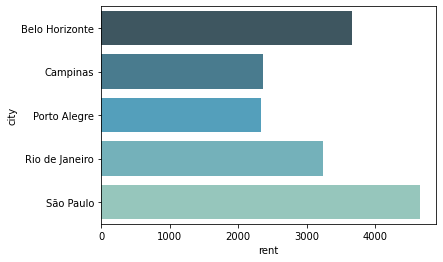

In [21]:
# Bar plot per city
rent_by_city = rent_df.groupby('city')['rent'].mean().reset_index()
sns.barplot(x='rent',
            y='city',
            data=rent_by_city,
            palette='GnBu_d')


In [18]:
rent_df.groupby('city')['rent'].mean()


city
Belo Horizonte    3664.127981
Campinas          2364.290739
Porto Alegre      2337.699916
Rio de Janeiro    3232.904064
São Paulo         4652.793783
Name: rent, dtype: float64

In [133]:
# Check mean by rent and total rent by each city
rent_df.groupby('city')['rent', 'rent_total'].mean().sort_values('rent', ascending=False)

,rent,rent_total
city,,
São Paulo,4652.793783,6380.831833
Belo Horizonte,3664.127981,6315.242448
Rio de Janeiro,3232.904064,4611.684877
Campinas,2364.290739,3173.276671
Porto Alegre,2337.699916,2989.782900


With this basic stats we can extract intersting information. 

- For all cities
    - In general, 75% of rents are lower than R$5000 
    - Mean rent is around R$ 3896
    - High amplitude of values, min: 450 and max: 45000
    - 

- By city
    - Sao Paulo have the higher average rent  
    - Sao Paulo have 75% of rents are lower than R$6000 (higher than all cities)
    - Porto Alegre has the lower average rent 

array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f1b13080670>,
      dtype=object)

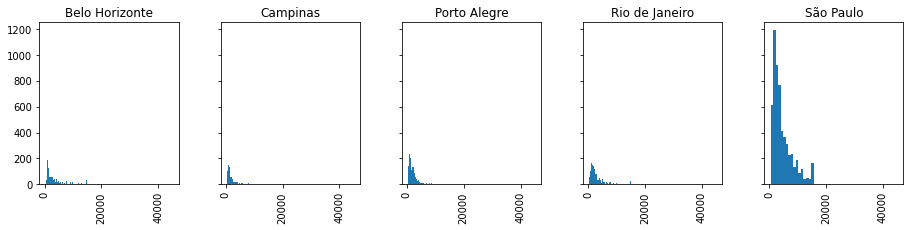

In [137]:
# Plot rent histogram by each city
rent_df['rent'].hist(by=rent_df['city'], 
                     figsize=(15,3), 
                     sharex=True, 
                     sharey=True, 
                     bins=50, 
                     layout=(1,5))

In [29]:
# Considering the higher rents as above 0.75 quantile
# Lets classify the dataset 
rent_category = rent_df['rent'].quantile(q=0.75)
rent_df['rent_class'] = ['high' if value > rent_category else 'low' for value in rent_df['rent']]

# Classified class count
rent_df['rent_class'].value_counts()

low     8153
high    2539
Name: rent_class, dtype: int64

In [175]:
# Describe rent class 
rent_df.groupby('rent_class')['bathroom'].describe()

,count,mean,std,min,25%,50%,75%,max
rent_class,,,,,,,,
high,2539.0,3.729027,1.445840,1.0,3.0,4.0,5.0,10.0
low,8153.0,1.772108,1.018148,1.0,1.0,1.0,2.0,7.0


In [206]:
# What is the criteria of highest rent?
# Does the difference among cities is significant?
# How to test this?


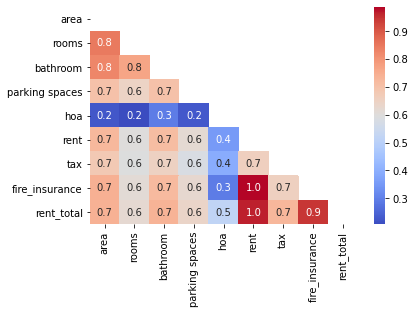

In [221]:
# Check number of bathrooms in highest rents
rent_correlation = rent_df.corr(method='spearman')

# Masking to get the inferior matrix
mask = np.triu(rent_correlation)

# Plotting
sns.heatmap(rent_correlation, cmap='coolwarm', mask=mask, annot=True, fmt='.1f')

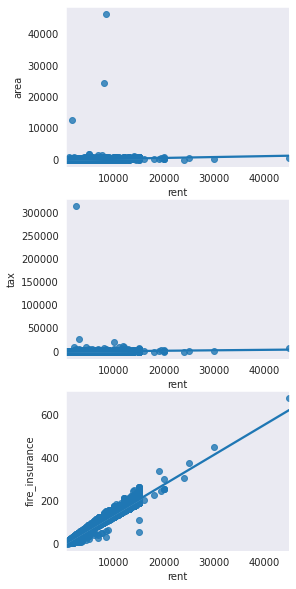

In [27]:
sns.set_style('dark')

# Seaborn regplot
fig, axes = plt.subplots(ncols=1, nrows=3, figsize=(4,10))
axes.flatten()
for col, ax in zip(['area', 'tax', 'fire_insurance'], axes):
    sns.regplot(x=rent_df['rent'], y=rent_df[col], ax=ax)

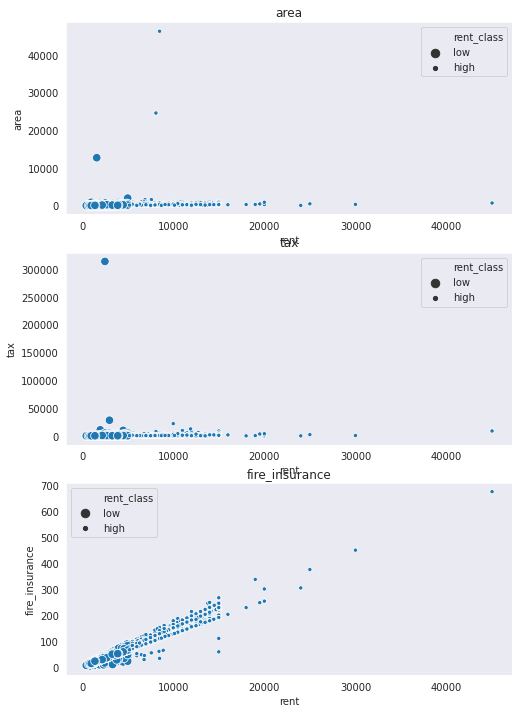

In [35]:
# Seaborn scatterplot
fig, axes = plt.subplots(ncols=1, nrows=3, figsize=(8,12))
axes.flatten()
for col, ax in zip(['area', 'tax', 'fire_insurance'], axes):
    sns.scatterplot(x=rent_df['rent'], y=rent_df[col], 
                    size=rent_df['rent_class'],
                    ax=ax)
    ax.set_title(col)